In [1]:
import pandas as pd
import sys


sys.path.append('../../')
from src.plot_helpers import plot_experiment_range,plot_correlation_matrix
from src.transform import transform_diff_avg,load_json

ref_cols = load_json("../../json/locations.json")["ref_palas"]

## Load data

In [2]:
df = pd.read_csv('../../data/clean_data/all_sensors.csv',index_col=0,parse_dates=True)
df

/tmp/ipykernel_1963385/2544046345.py:1: DtypeWarning: Columns (6,26) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('../../data/clean_data/all_sensors.csv',index_col=0,parse_dates=True)


,aqi_palas,averaging,cn,co,co2,dcn,formaldehyde,global_error,humidity,indoor_nox_index,...,temperature,tvoc,tvoc_ppb,voc,volume_flow,x10_dcn,x16_dcn,x50_dcn,x84_dcn,x90_dcn
datetime,,,,,,,,,,,,,,,,,,,,,
2024-10-11 13:24:18,NaN,NaN,NaN,NaN,566.00,NaN,3.0,NaN,58.00,NaN,...,20.50,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-10-11 13:33:57,NaN,NaN,NaN,NaN,528.00,NaN,11.0,NaN,58.00,NaN,...,21.00,87.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-10-11 13:43:57,NaN,NaN,NaN,NaN,596.00,NaN,36.0,NaN,57.00,NaN,...,22.20,103.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-10-11 13:44:34,NaN,NaN,NaN,NaN,675.00,NaN,42.0,NaN,57.00,NaN,...,22.70,103.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2024-10-11 13:54:27,NaN,NaN,NaN,NaN,701.00,NaN,41.0,NaN,57.00,NaN,...,23.00,102.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-10-23 13:31:00,82.00,60.0,910.15,NaN,1047.80,->,NaN,0.0,58.04,NaN,...,23.08,NaN,NaN,6.25,1.0,0.19,0.2,0.24,0.31,0.33
2024-10-23 13:32:00,82.00,60.0,930.16,NaN,1041.80,->,NaN,0.0,58.21,NaN,...,23.09,NaN,NaN,6.21,1.0,0.19,0.2,0.24,0.31,0.33
2024-10-23 13:33:00,82.77,60.0,942.98,NaN,1049.43,->,NaN,0.0,58.21,NaN,...,23.08,NaN,NaN,6.33,1.0,0.19,0.2,0.24,0.31,0.33


In [3]:
df_ref = df.loc[df['sensor'] == 'ref_sensor'][ref_cols]
df_ref

,pm_1.0,pm_2.5,pm_4.0,pm_10,pm_tot,co2,voc,cn,m1_0,m2_0,...,x90_dcn,temperature,pressure,humidity,aqi_palas,infection_risk_index,volume_flow,power_volume_flow,global_error,dcn
datetime,,,,,,,,,,,,,,,,,,,,,
2024-09-24 00:00:00,6.80,6.95,7.27,6.80,6.80,630.00,3.82,193.09,0.24,0.06,...,0.31,24.27,996.18,49.80,78.00,0.35,1.0,15.66,0.0,->
2024-09-24 00:01:00,6.81,6.91,7.21,6.75,6.75,629.67,3.75,198.89,0.24,0.06,...,0.31,24.22,996.14,49.81,78.00,0.34,1.0,15.68,0.0,->
2024-09-24 00:02:00,6.94,7.19,7.69,7.18,7.20,628.17,3.75,198.12,0.24,0.06,...,0.31,24.20,996.13,49.84,78.00,0.35,1.0,15.67,0.0,->
2024-09-24 00:03:00,6.89,6.99,7.28,6.82,6.82,628.07,3.81,197.39,0.24,0.06,...,0.30,24.24,996.10,49.80,78.00,0.35,1.0,15.64,0.0,->
2024-09-24 00:04:00,7.18,7.36,7.70,7.21,7.21,628.10,3.77,200.98,0.24,0.06,...,0.31,24.26,996.16,49.79,78.00,0.35,1.0,15.66,0.0,->
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-10-23 13:31:00,39.69,40.76,43.07,40.28,40.34,1047.80,6.25,910.15,0.26,0.07,...,0.33,23.08,1019.05,58.04,82.00,1.59,1.0,15.69,0.0,->
2024-10-23 13:32:00,39.79,41.22,44.75,43.45,44.38,1041.80,6.21,930.16,0.26,0.07,...,0.33,23.09,1019.08,58.21,82.00,1.57,1.0,15.71,0.0,->
2024-10-23 13:33:00,40.25,41.56,44.59,41.73,76.67,1049.43,6.33,942.98,0.26,0.09,...,0.33,23.08,1019.08,58.21,82.77,1.57,1.0,15.64,0.0,->


## Correlation matrix

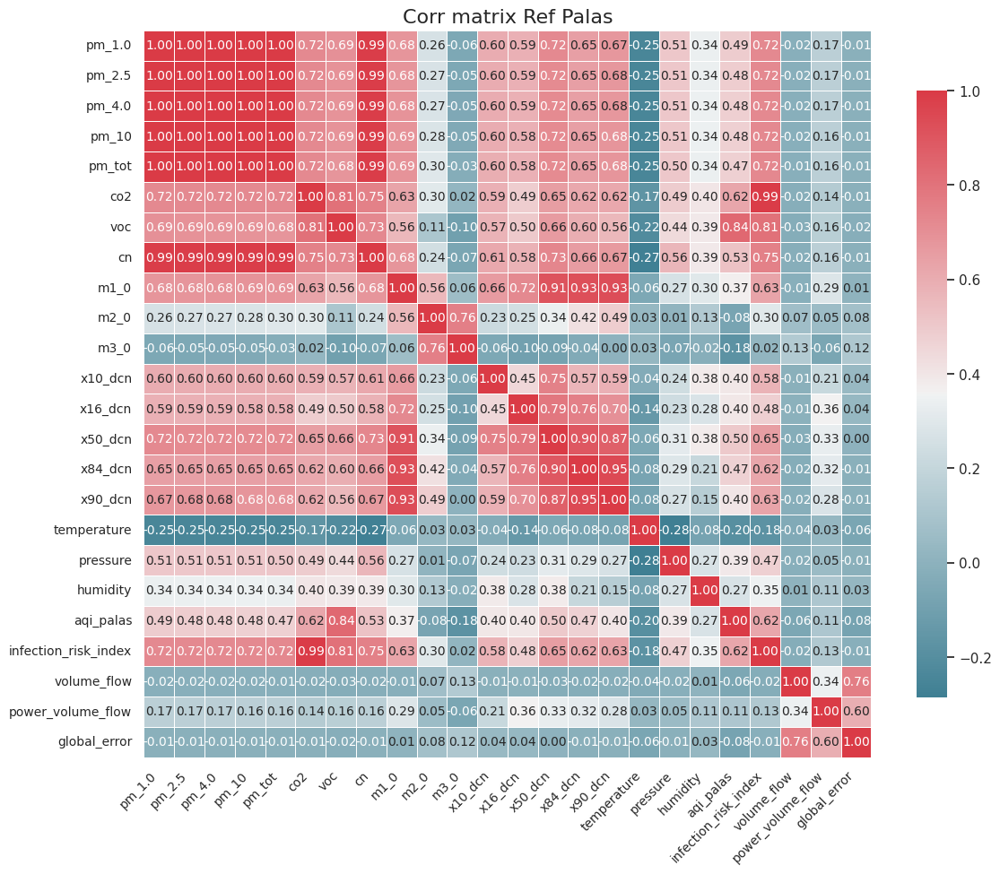

Index(['pm_1.0', 'pm_2.5', 'pm_4.0', 'pm_10', 'pm_tot', 'co2', 'voc', 'cn',
       'm1_0', 'm2_0', 'm3_0', 'x10_dcn', 'x16_dcn', 'x50_dcn', 'x84_dcn',
       'x90_dcn', 'temperature', 'pressure', 'humidity', 'aqi_palas',
       'infection_risk_index', 'volume_flow', 'power_volume_flow',
       'global_error', 'dcn'],
      dtype='object')

In [4]:
plot_correlation_matrix(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean().corr(),title=f"Corr matrix Ref Palas")

df_ref.columns

## PAHs

### Time series plots

In [5]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean(),col_names=['pm_10','pm_1.0','pm_4.0','pm_2.5','pm_tot'],max_value=100)


### Diff plot

In [16]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean().diff(),col_names=['pm_10',],min_value=-20,max_value=20)

### diff percentage plot

In [18]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean().pct_change() * 100,col_names=['pm_10'],max_value=100)

/tmp/ipykernel_1918658/3221952736.py:1: FutureWarning:

The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.



## xx_dcn

In [25]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean(),col_names=['x10_dcn','x16_dcn','x50_dcn','x84_dcn','x90_dcn'],max_value=0.35)

## CO2

### Time series

In [27]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean(),col_names=['co2'])

### diff plot

In [28]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean().pct_change() * 100,col_names=['co2'])

/tmp/ipykernel_1918658/3936128323.py:1: FutureWarning:

The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.



## Temperature, Humidity, AQI palas and infection risk index

### time series plot

In [36]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean(),col_names=['temperature','humidity','aqi_palas','infection_risk_index'])


### diff plot

In [39]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean().pct_change() * 100,col_names=['aqi_palas','infection_risk_index'],max_value=150)

/tmp/ipykernel_1918658/2194526930.py:1: FutureWarning:

The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.



## VOC

### Timeseries

In [30]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean(),col_names=['voc'])

### diff plot

In [33]:
plot_experiment_range(df=df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean().pct_change() * 100,col_names=['voc'],max_value=400)

/tmp/ipykernel_1918658/1346513187.py:1: FutureWarning:

The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.



## Overall analysis

In [47]:
diff_df = transform_diff_avg(df_ref.select_dtypes(include=['int64', 'float64']).resample('240s').mean())
#diff_df.dropna(axis=1,inplace=True)
diff_df.drop(['pm_1.0','pm_2.5','pm_4.0','pm_tot','x10_dcn','x16_dcn','x50_dcn','x84_dcn','x90_dcn','global_error'],inplace=True)

/home/usr1_tt/collocation_study/notebooks/sensor/../../src/transform.py:15: FutureWarning:

The default fill_method='pad' in DataFrame.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.



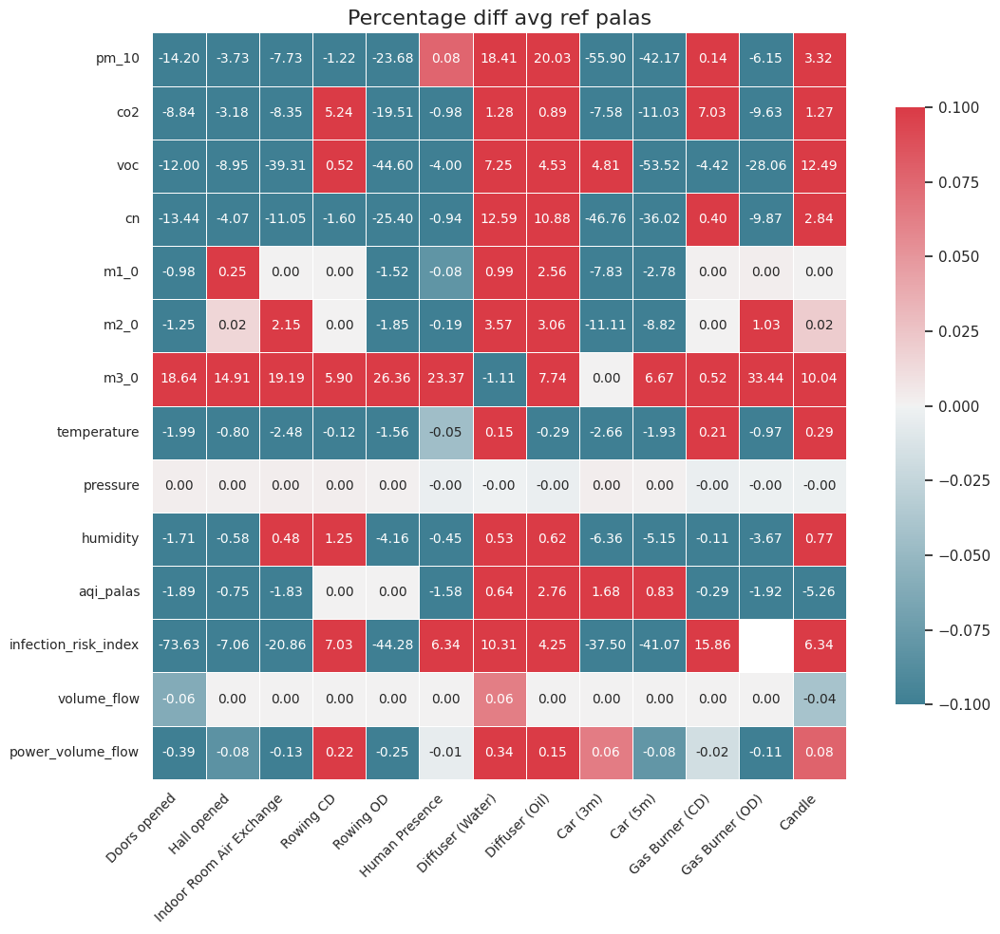

In [48]:
plot_correlation_matrix(diff_df,title="Percentage diff avg ref palas")